# Monte Carlo TD2

## 1.durée d'une simulation

### 1.1

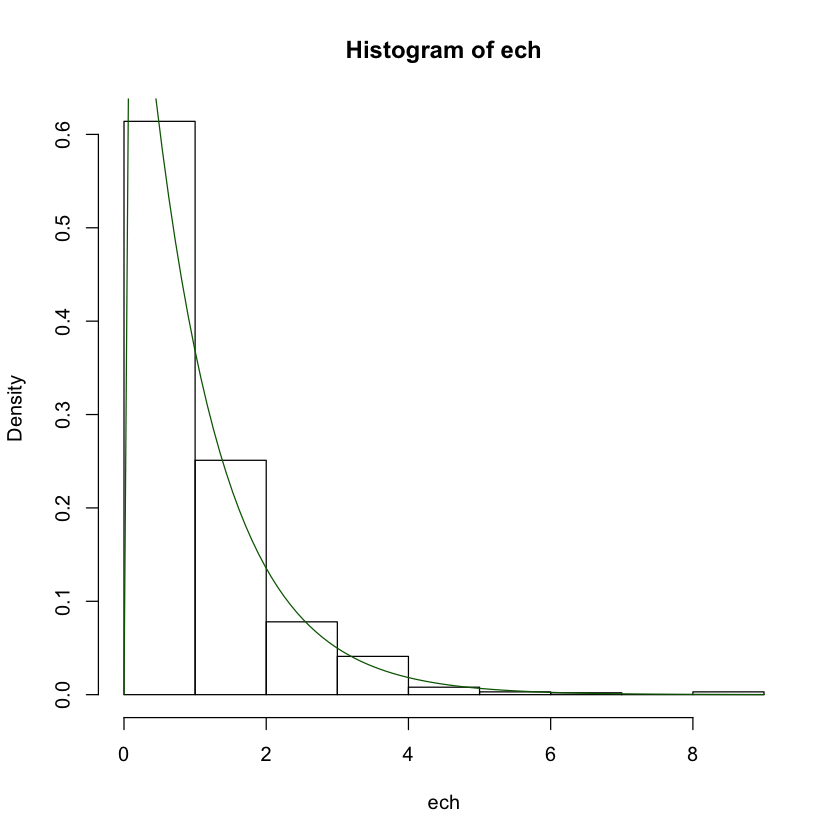

In [1]:
ech<--log(runif(1000,0,1))
hist(ech,probability=T)
curve(dexp(x,1),col="darkgreen",add=T)

### 1.2

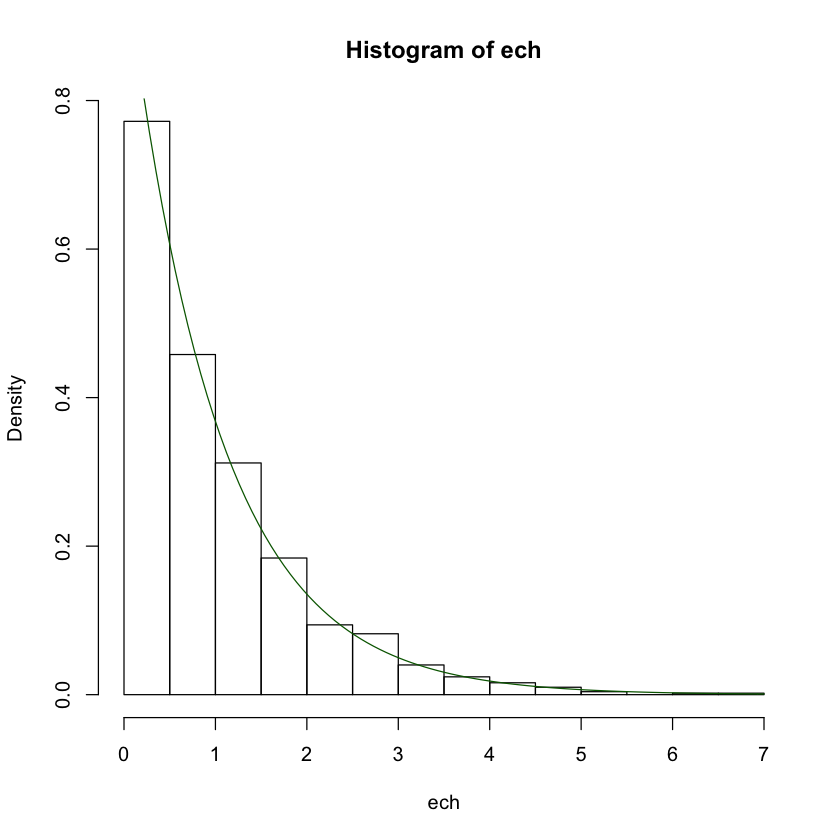

In [2]:
ech<-rexp(1000,1)
hist(ech,probability=T)
curve(dexp(x,1),col="darkgreen",add=T)

### 1.3

In [3]:
t0=proc.time()
a<-runif(10^6)
proc.time()-t0

   user  system elapsed 
  0.123   0.007   0.165 

#### comparation

In [4]:
t0=proc.time()
ech<--log(runif(10000,0,1))
proc.time()-t0
t0=proc.time()
ech<-rexp(10000,1)
proc.time()-t0

   user  system elapsed 
  0.004   0.000   0.005 

   user  system elapsed 
  0.004   0.001   0.005 

## 2.Lien géométrique/exponentielle

### 2.1

Soit $Y_n$ suit une loi de géométrique, $\{ Y_n = k \} = \{ B_1=0,\dotsc,B_k = 0,B_{k+1}=1 \}$.

### 2.2

On veut simuler Bn qui suit une loi de Bernoulli.

In [5]:
p<-1/3
B1<-ceiling(runif(1)-(1-p))
count<-0
p<-1/3
while(B1==0){
  B1<-ceiling(runif(1)-(1-p))
  print(B1)
  count<-count+1
}
print(count-1)

[1] 1
[1] 0


count-1 suit une loi géométrique.

Quand p est proche de 0, il prend bcp de fois avant réussir.

### 2.3

Par les calculs :

$$\mathrm{P}(x=k)=\mathrm{e}^{-\lambda(k-1)}-]mathrm{e}^{-\lambda k}$$

on fait :

$$p=1-\mathrm{e}^{-\lambda}$$
$$\lambda=-\mathrm{log}(1-p)$$


In [7]:
p=1/3
lambda<--log(1-p)
t0=proc.time()
ech<-ceiling(-log(runif(1000000))/lambda)
mean(ech)# théoriquement, il égale à 1/p
proc.time()-t0
p<-1/3
t0=proc.time()
ech<-rgeom(1000000,p)
mean(ech)
proc.time()-t0

[1] 2.998749

   user  system elapsed 
  0.188   0.006   0.222 

[1] 1.994831

   user  system elapsed 
  0.207   0.003   0.215 

On peut voir que ce qu'on fait est plus vite que rgeom de R!

Pourquoi? parceque le R regard rgeom comme un cas spéciale de loi NB.


## 3.Nul n'est censé ignorer la loi normal

### 3.1
#### simulation d'une loi de Laplace

On va simule 100000 observations qui suit une loi normale.

simuler une loi de bernoulli à valeur à ${+1,-1}$.


   user  system elapsed 
  0.734   0.076   1.154 

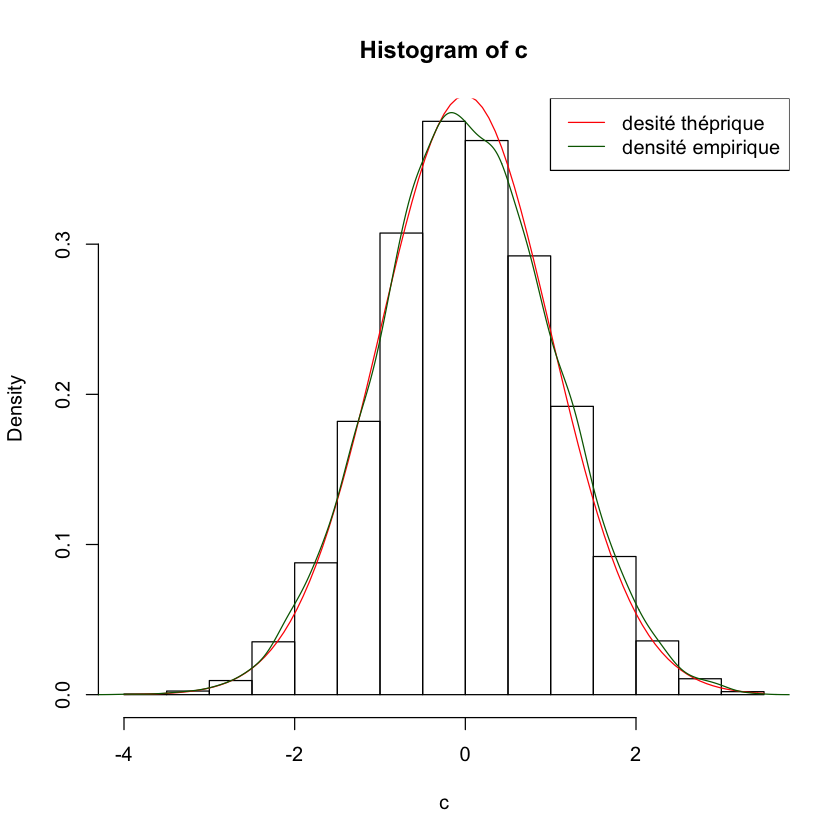

In [8]:
m<-sqrt(2*exp(1)/pi)
r<- function (x) exp(-0.5*((abs(x)-1)^2))
c<-c()
t0=proc.time()
count<-0
while(count<10000){ 
ech_ber<-(ceiling((runif(1)-1/2))-1/2)*2
ech<--log(runif(1))*ech_ber
if (runif(1)<r(ech)) {
  c<-append(c,ech)
  count<-count+1
}}
proc.time()-t0
hist(c,probability=T)
curve(dnorm(x),add=T,col="red")
lines(density(c),col="darkgreen")
legend("topright",c("desité théprique","densité empirique"),col=c("red","darkgreen"),lty=c(1,1))

Ils coincident parfaitement.

### 3.2

#### la méthode de Box-Muller.


   user  system elapsed 
  0.061   0.006   0.082 

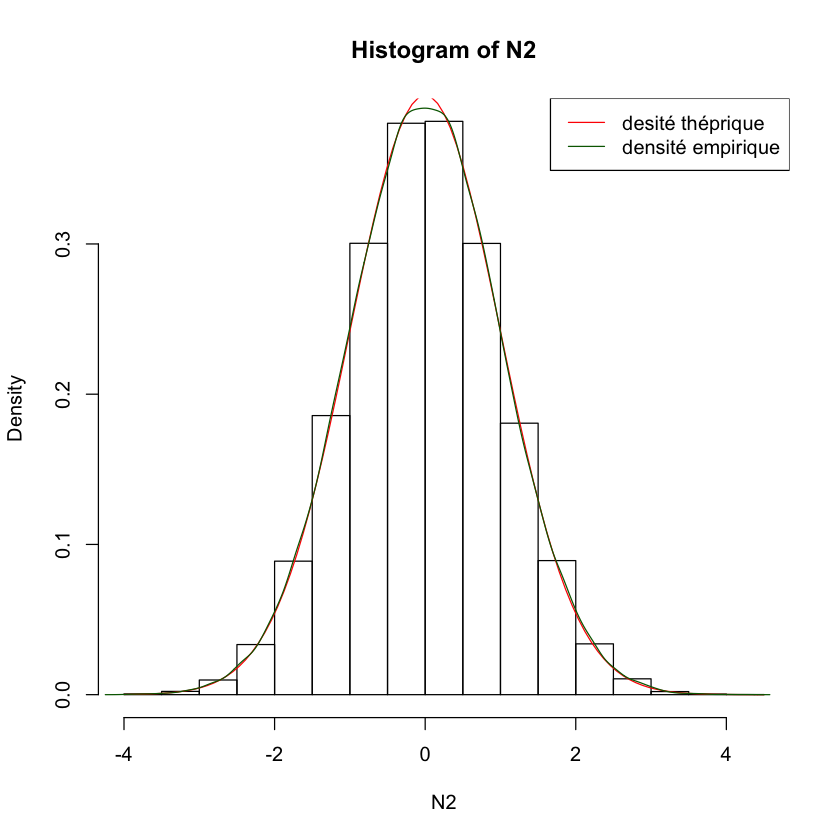

In [9]:
t0<-proc.time()
n<-50000
r<-sqrt(-2*log(runif(n)))
theta<-2*pi*runif(n)
N2<-c(r*cos(theta),r*sin(theta))
hist(N2,probability=T)
curve(dnorm(x),add=T,col="red")
lines(density(N2),col="darkgreen")
legend("topright",c("desité théprique","densité empirique"),col=c("red","darkgreen"),lty=c(1,1))
proc.time()-t0

Cette méthode est bcp plus vite que la méthode rejet que l'on a fait.

### 3.3

In [10]:
n<-1000
r<-sqrt(-2*log(runif(n)))
theta<-2*pi*runif(n)
x1<-r*cos(theta)
x2<-r*sin(theta)
X<-rbind(x1,x2)

X est une échantillon qui suit une loi normale std de $dim 2$.

Loading required package: Matrix

Attaching package: ‘expm’

The following object is masked from ‘package:Matrix’:

    expm

Note: method with signature ‘symmetricMatrix#missing’ chosen for function ‘Schur’,
 target signature ‘dsyMatrix#missing’.
 "dsyMatrix#ANY" would also be valid


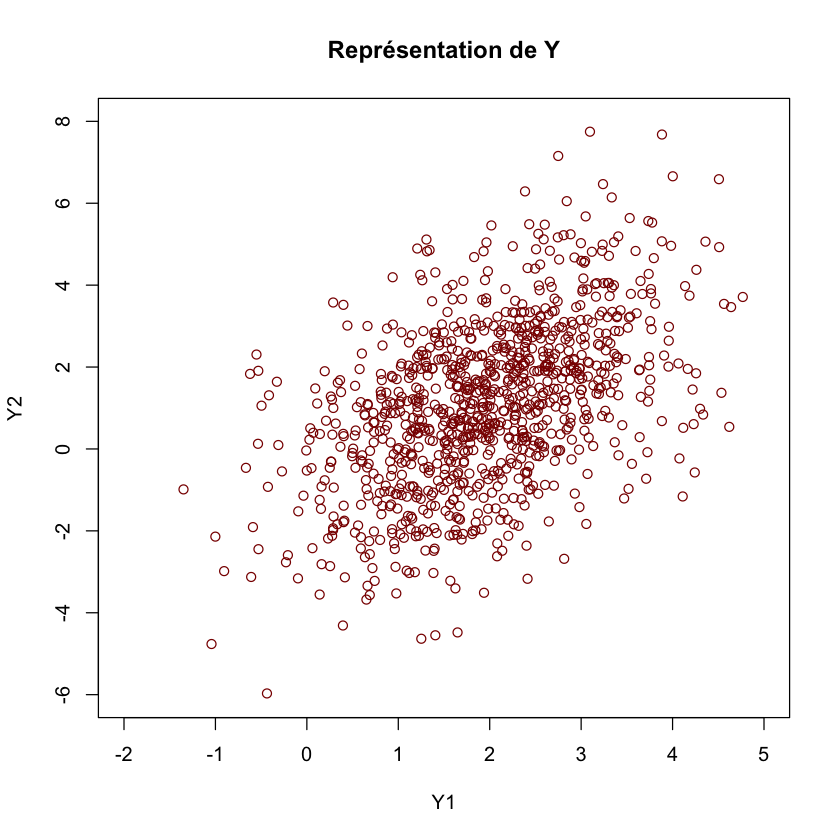

In [11]:
gamma=matrix(c(1,1,1,4),nrow=2,byrow = T)
library(expm)#le package est utilisé pour calculer le sqrt(resp. log, exp) d'une matice.
A<-sqrtm(gamma)
B<-matrix(c(2,1),nrow = 2)
f<-function (x) A%*%x+B
Y<-apply(X,2,f)
plot(Y[1,],Y[2,],col="darkred",xlim=c(-2,5),ylim=c(-6,8),main="Représentation de Y",
     xlab="Y1",ylab="Y2")

On voit bien une ellipse.

In [12]:
apply(Y,1,mean)
cov(t(Y))

[1] 1.950826 1.070629

1.0272321,0.9893694
0.9893694,4.0104460


#### Si on veut utiliser directement le package "MASS"

0.9789022,1.1140532
1.114053,4.257614


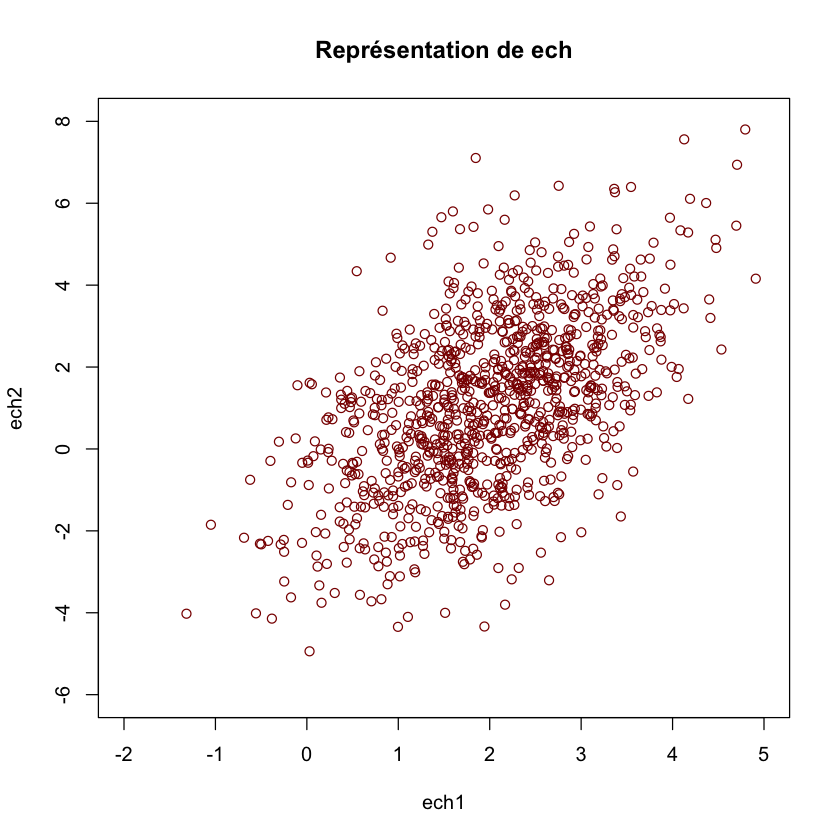

In [13]:
n=1000
m=c(2,1)
gamma=matrix(c(1,1,1,4),nrow=2)
library(MASS)
ech=mvrnorm(n,m,gamma)
cov(ech)

plot(ech[,1],ech[,2],col="darkred",xlim=c(-2,5),ylim=c(-6,8),main="Représentation de ech",
     xlab="ech1",ylab="ech2")

## 4.Méfiez-vous des mélanges !

### 4.1

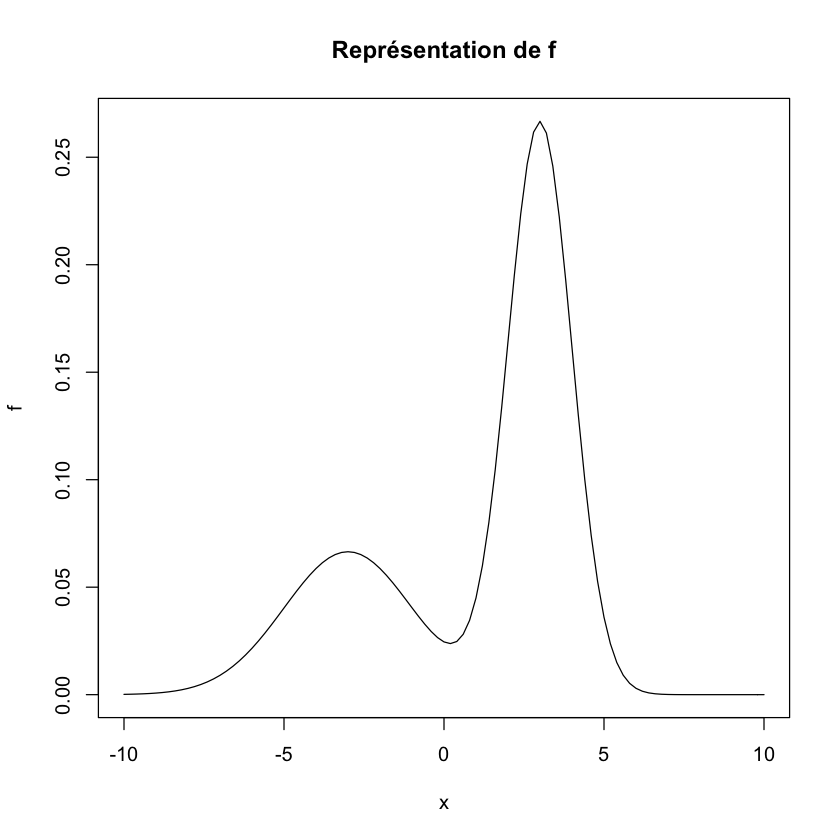

In [14]:
f<- function (x) (1/(6*sqrt(2*pi)))*exp(-(x+3)^2/8)+(2/(3*sqrt(2*pi))*exp(-(x-3)^2/2))
plot(f,xlim = c(-10,10),main="Représentation de f")

### 4.2 & 4.3

on regard X comme une loi mélange de $\mathcal{N}(-3,2)$ et $\mathcal{N}(3,1)$.

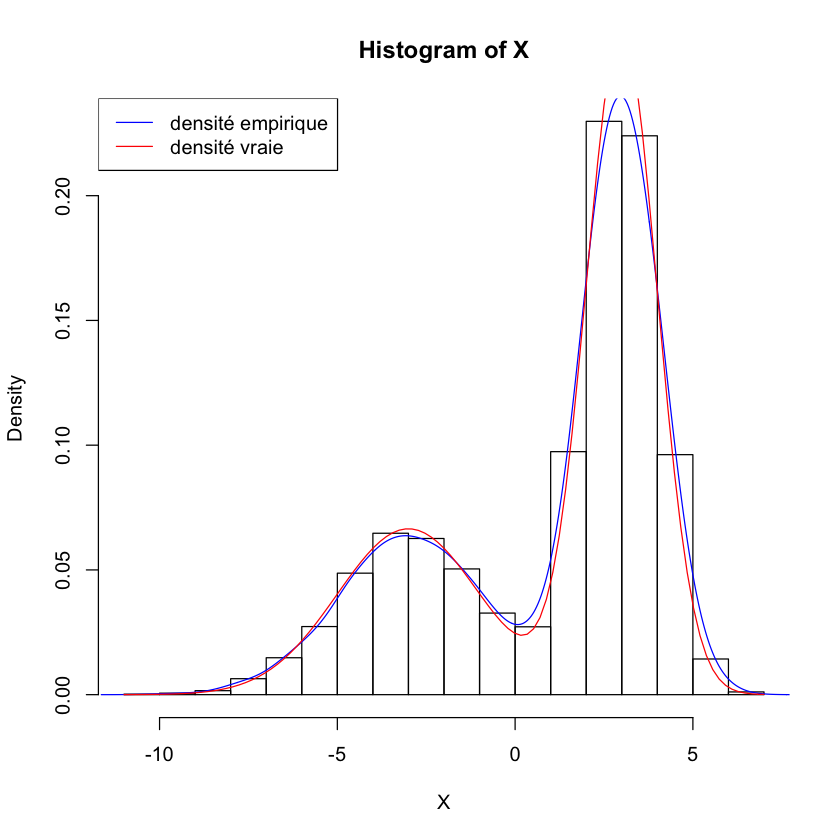

In [15]:
u<-runif(10000)
X<-(u<1/3)*rnorm(10000,-3,2)+(u>1/3)*rnorm(10000,3,1)
hist(X,probability = T)
lines(density(X),col="blue")
curve(f(x),add=T,col="red")
legend("topleft",c("densité empirique","densité vraie"),col = c("blue","red"),lty = c(1,1))

Il coincide parfaitement !


## 5.Représentation et simulation de copules.
### 5.1
#### Initiation


In [17]:
library(rgl)
x<-seq(0.01,1,0.01)
y<-x

#### copule_min

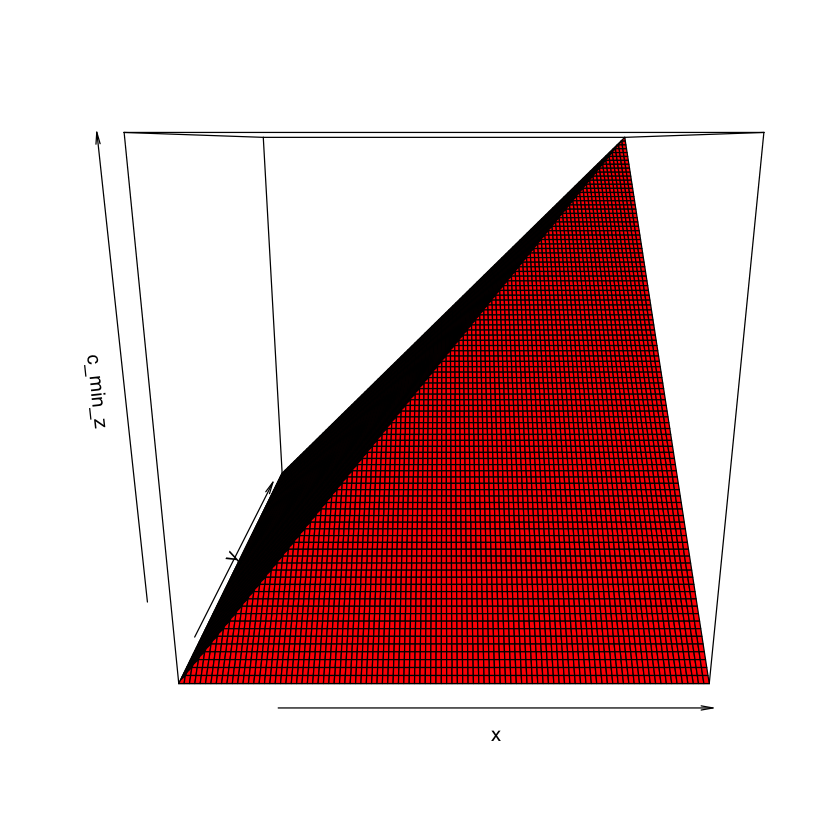

In [18]:
c_min<- function(x,y) {
  X<-rbind(x,y)
  return(apply(X,2,min))
}
c_min_z<-outer(x,y,c_min)
#surface3d(x, y, c_min_z,col="red")
persp(x,y,c_min_z,col="red")

#### copule anti-comonotone

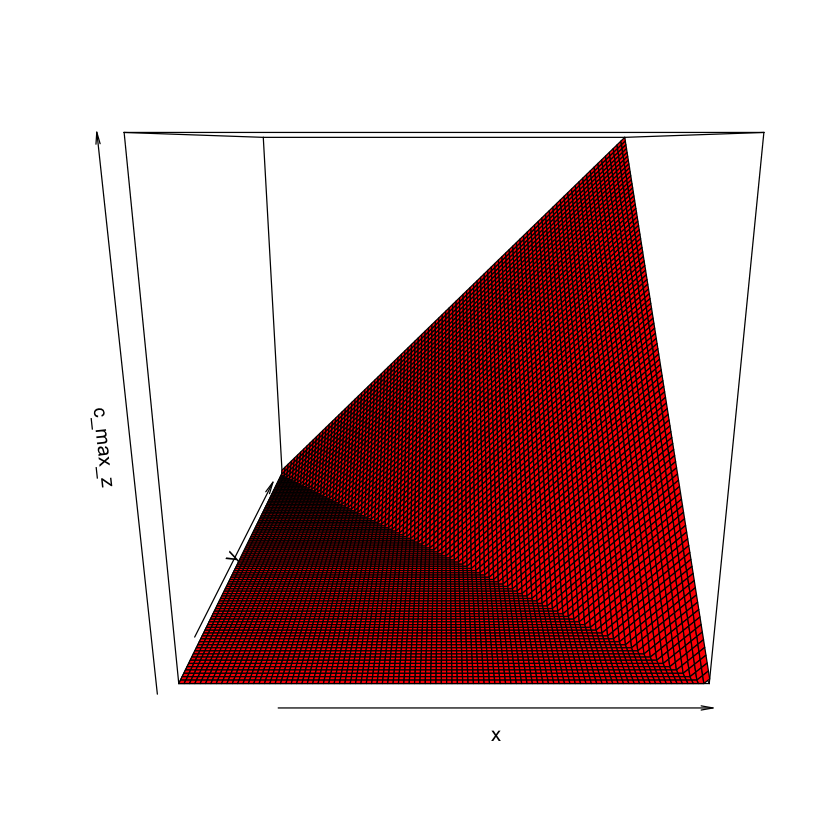

In [19]:
c_max<- function(x,y) {
  X<-rbind(x,y)
  f<-function(u){ max(u[1]+u[2]-1,0)}
  return(apply(X,2,f))
}
c_max_z<-outer(x,y,c_max)
persp(x,y,c_max_z,col="red")
#surface3d(x, y, c_max_z,col="red")

#### copule indépendante

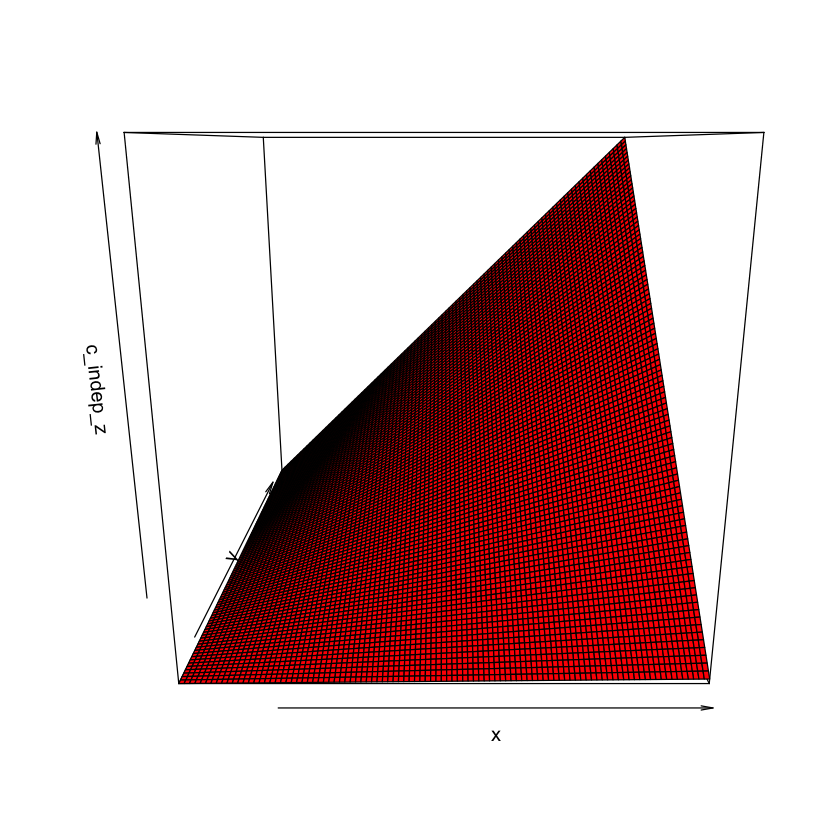

In [20]:
c_indep_z<-outer(x,y,"*")
persp(x,y,c_indep_z,col="red")
#surface3d(x, y, c_indep_z,col="red")

#### copule de clayton(de paramètre 1)

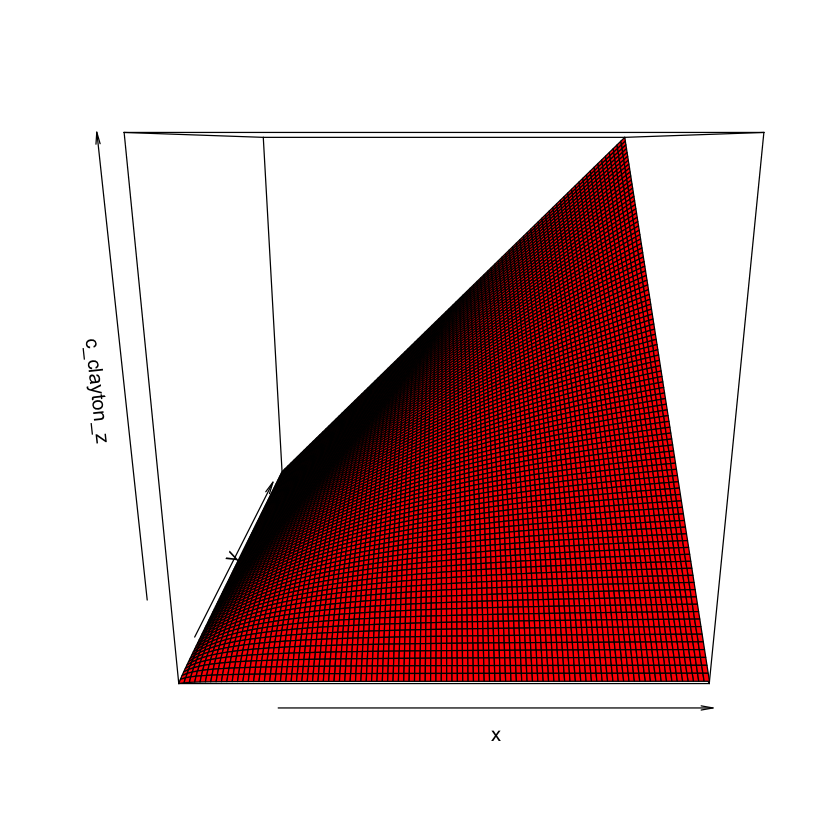

In [22]:
theta=1
c_clayton<- function(x,y) {
  X<-rbind(x,y)
  f<-function(u){ (u[1]^(-theta)+u[2]^(-theta)-1)^(-1/theta)}
  return(apply(X,2,f))
}
c_clayton_z<-outer(x,y,c_clayton)
persp(x,y,c_clayton_z,col="red")
#surface3d(x, y, c_clayton_z,col="red")

#### copule gaussien

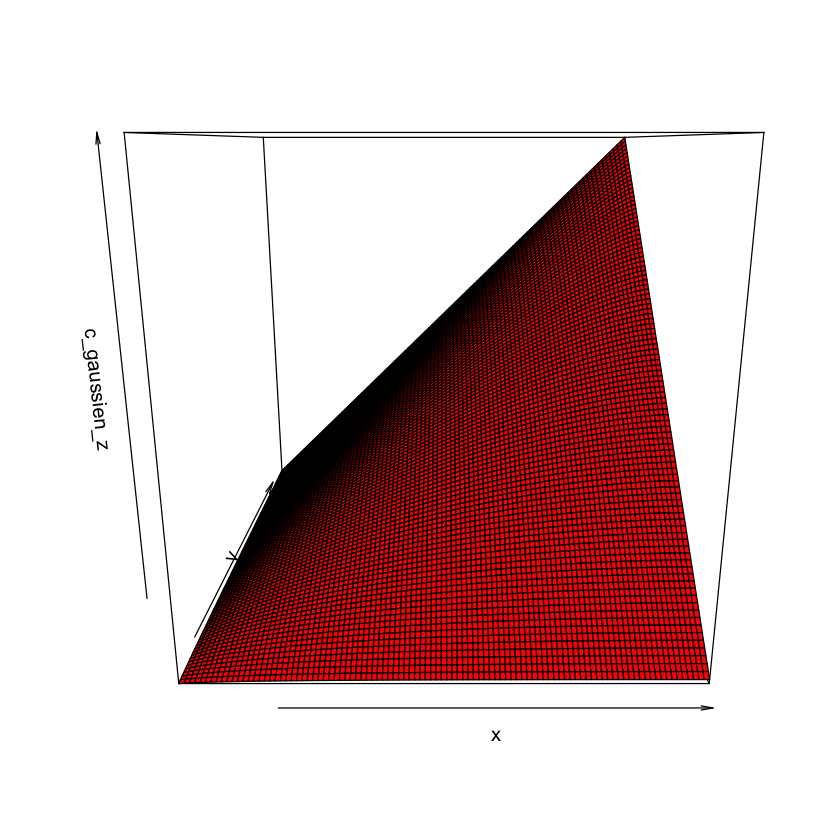

In [24]:
p=1/2
library(mvtnorm)
library(rgl)
x<-seq(0.01,1,0.01)
y<-x
c_gaussien<-function(x,y) {
  X<-rbind(x,y)
  f<-function(u){ 
    mean <- rep(0, 2)
    lower<- -Inf
    upper <- c(qnorm(min(1,u[1])),qnorm(min(1,u[2])))
    corr <- matrix(c(1,p,p,1),nrow = 2)
    pmvnorm(lower,upper,mean,corr) }
  return(apply(X,2,f))
}

c_gaussien_z<-outer(x,y,c_gaussien)
persp(x,y,c_gaussien_z,col="red")
#surface3d(x, y, c_gaussien_z,col="red")

### 5.2

In [83]:
library(MASS)
n = 10000
p<-1/2
gamma <- matrix(c(1,p,p,1),nrow = 2)
X=mvrnorm(n,rep(0,2),gamma)
u<-pnorm(X[,1])
v<-pnorm(X[,2])

$(u,v)$ est une échantiollon dont la fonction de repartion égale à la copule gaussien de paramètre $p$.

In [84]:
Y=rexp(n)
U1=runif(n)
U2=runif(n)
U=1/(1-log(U1)/Y)
V=1/(1-log(U2)/Y)

$(qnorm(U),qnorm(V))$ est un couple de uniform dont la fdr est c_clayton.

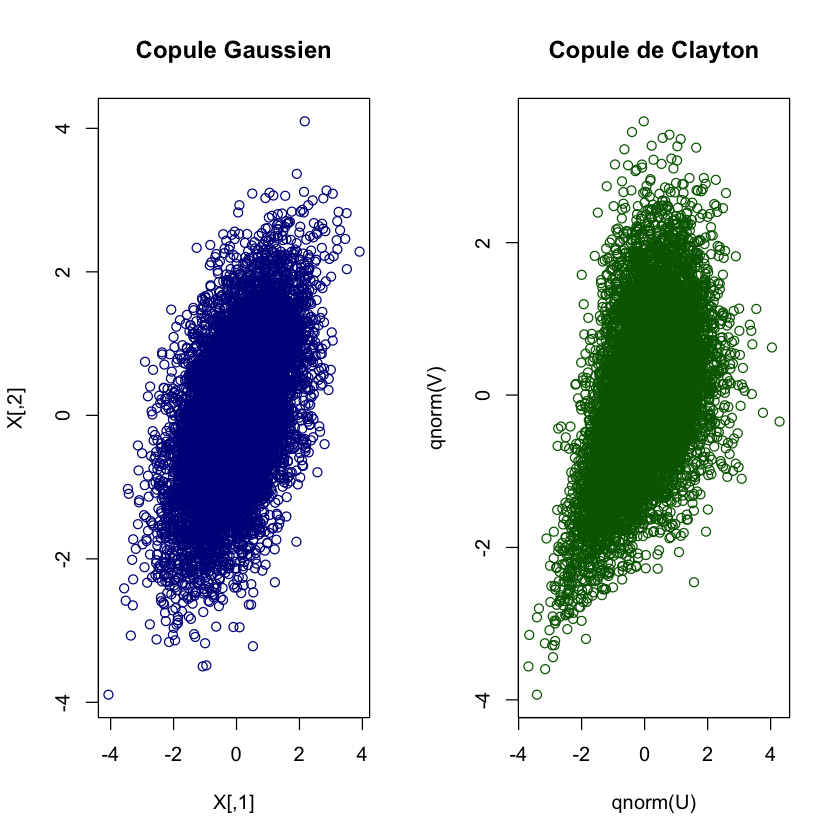

In [85]:
par(mfrow=c(1,2))
plot(X,main = "Copule Gaussien",col='darkblue')
plot(qnorm(U),qnorm(V),main = 'Copule de Clayton',col='darkgreen')

### 5.3

#### Simulation d'une loi de Laplace via la couple gaussienne

In [76]:
n<-10000
p<-1/2
gamma <- matrix(c(1,p,p,1),nrow = 2)
X=mvrnorm(n,rep(0,2),gamma)
u<-pnorm(X[,1])
v<-pnorm(X[,2])

$(u,v)$ est une échantiollon dont la fonction de repartion égale à la copule gaussien de paramètre $p$.

In [77]:
ech_ber1<-2*(ceiling(runif(n)-1/2)-1/2)
ech_exp1<--log(u)
ech_lap1_g<-ech_ber1*ech_exp1
ech_ber2<-2*(ceiling(runif(n)-1/2)-1/2)
ech_exp2<--log(v)
ech_lap2_g<-ech_ber2*ech_exp2

#### copule indépendante

In [78]:
ech_ber1<-2*round(runif(n))-1
ech_exp1<--log(runif(n))
ech_lap1<-ech_ber1*ech_exp1
ech_ber2<-2*round(runif(n))-1
ech_exp2<--log(runif(n))
ech_lap2<-ech_ber2*ech_exp2

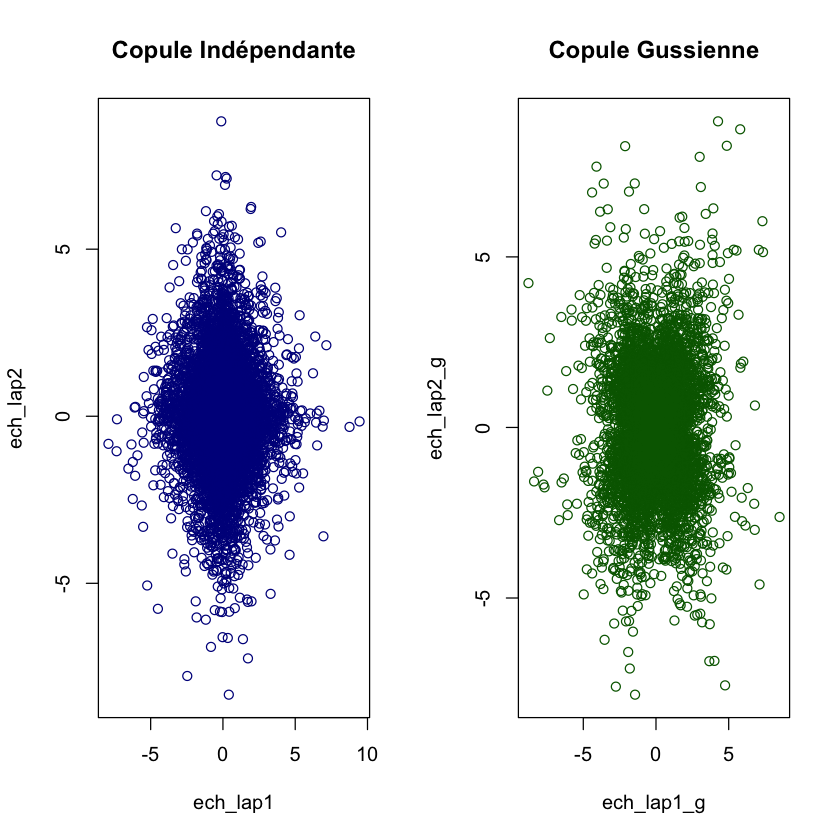

In [79]:
par (mfrow=c(1,2))
plot(ech_lap1,ech_lap2,main = 'Copule Indépendante',col='darkblue')
plot(ech_lap1_g,ech_lap2_g,main = 'Copule Gussienne',col='darkgreen')

## 6.Movement brownien, pont brownien.

### 6.1

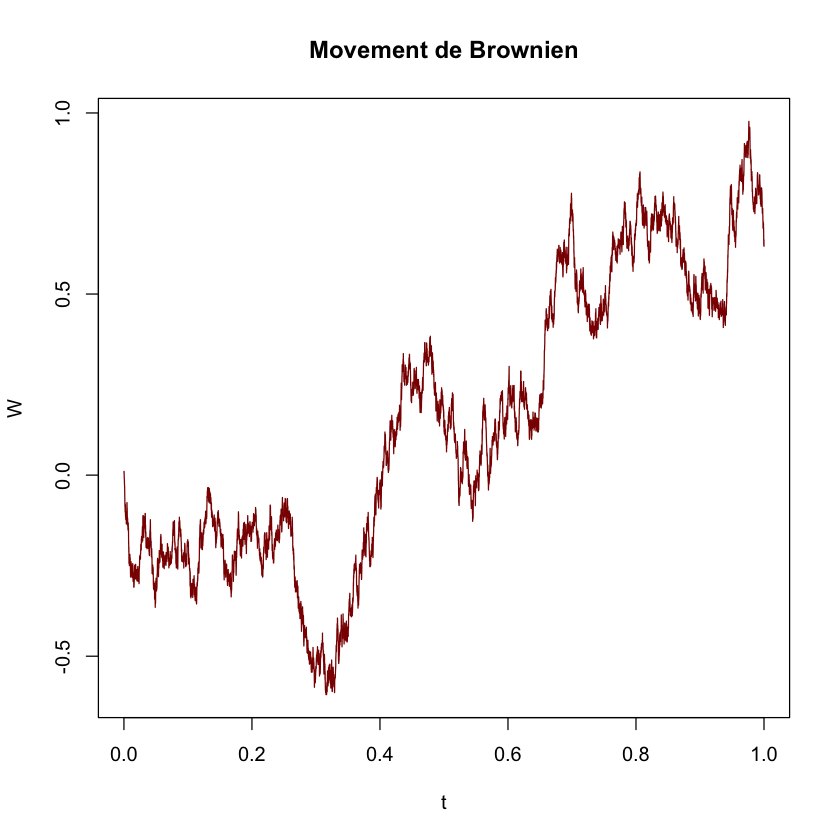

In [86]:
n<-10000
t<-seq(1/n,1,1/n)
u<-rnorm(n,0,sqrt(1/n))
W<-cumsum(u)
plot(t,W,type = 'l',col="darkred",main = 'Movement de Brownien')

### 6.2

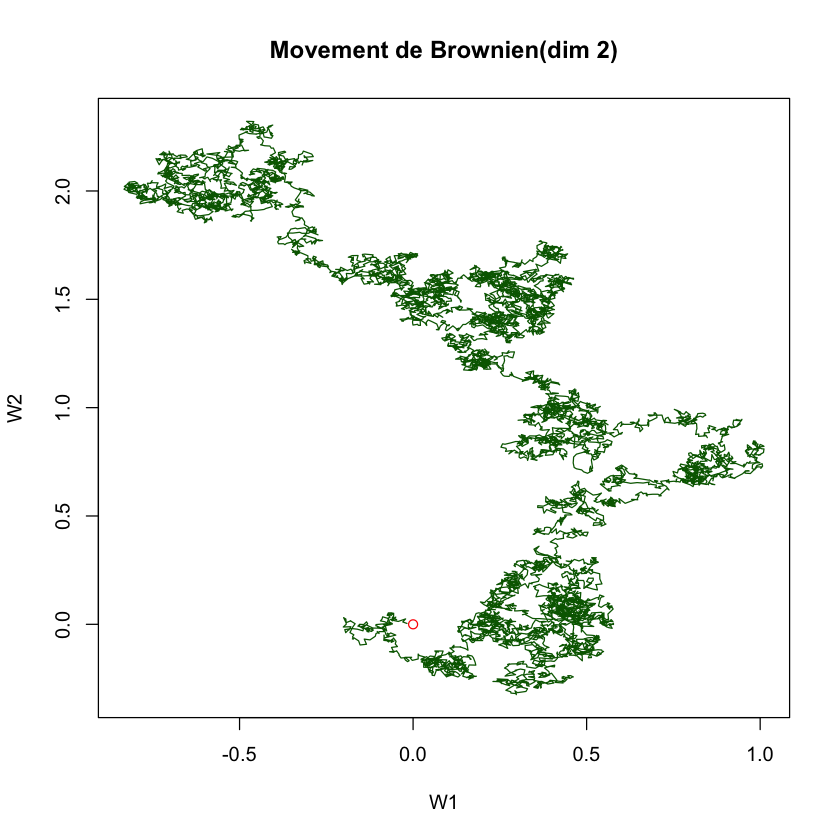

In [87]:
n<-10000
u1<-rnorm(n,0,sqrt(1/n))
W1<-cumsum(u1)
u2<-rnorm(n,0,sqrt(1/n))
W2<-cumsum(u2)
plot(W1,W2,type = 'l',col="darkgreen",main = 'Movement de Brownien(dim 2)')
points(0,0,col="red")

## 6.3

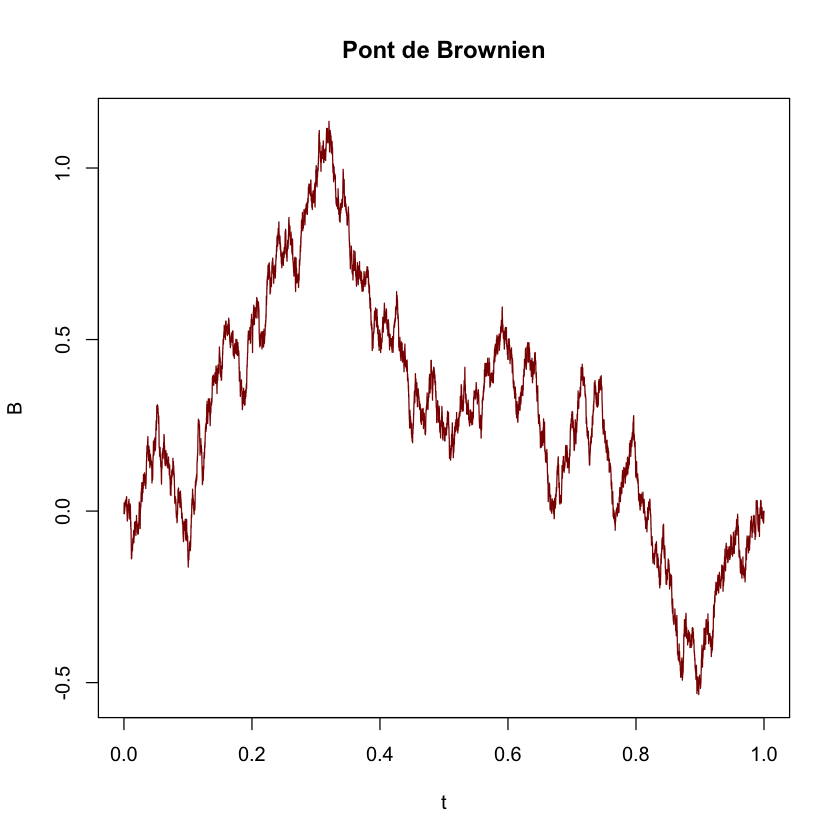

In [88]:
n<-10000
t<-seq(1/n,1,1/n)
u<-rnorm(n,0,sqrt(1/n))
W<-cumsum(u)
B<-rep(0,n)
for( i in 1:n) B[i]<-W[i]-t[i]*W[n]
plot(t,B,type = 'l',col="darkred",main = 'Pont de Brownien')

## 6.4(a)

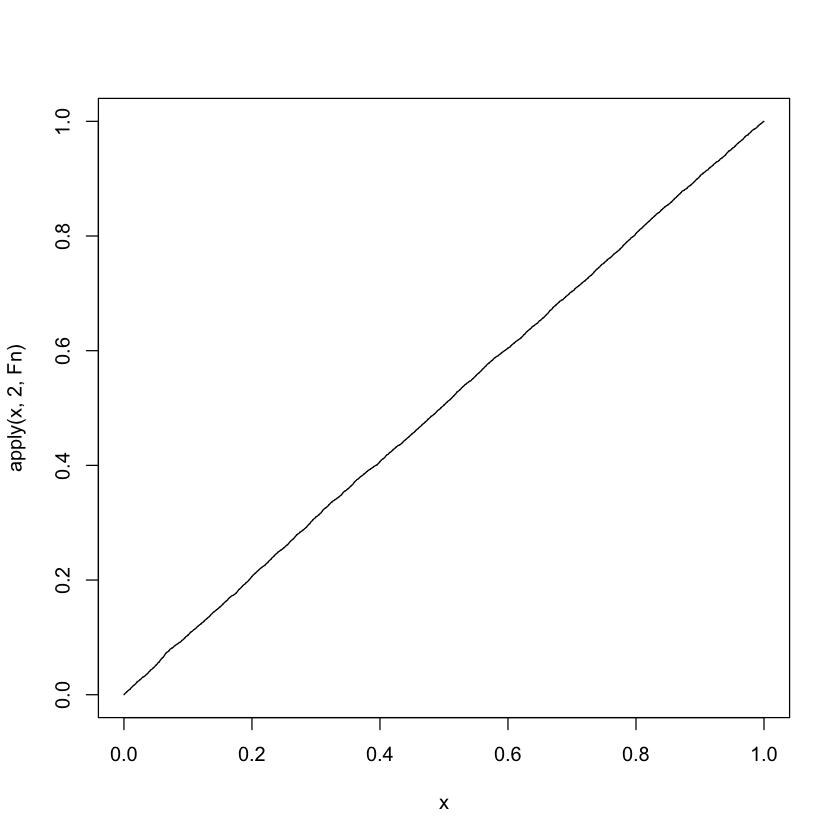

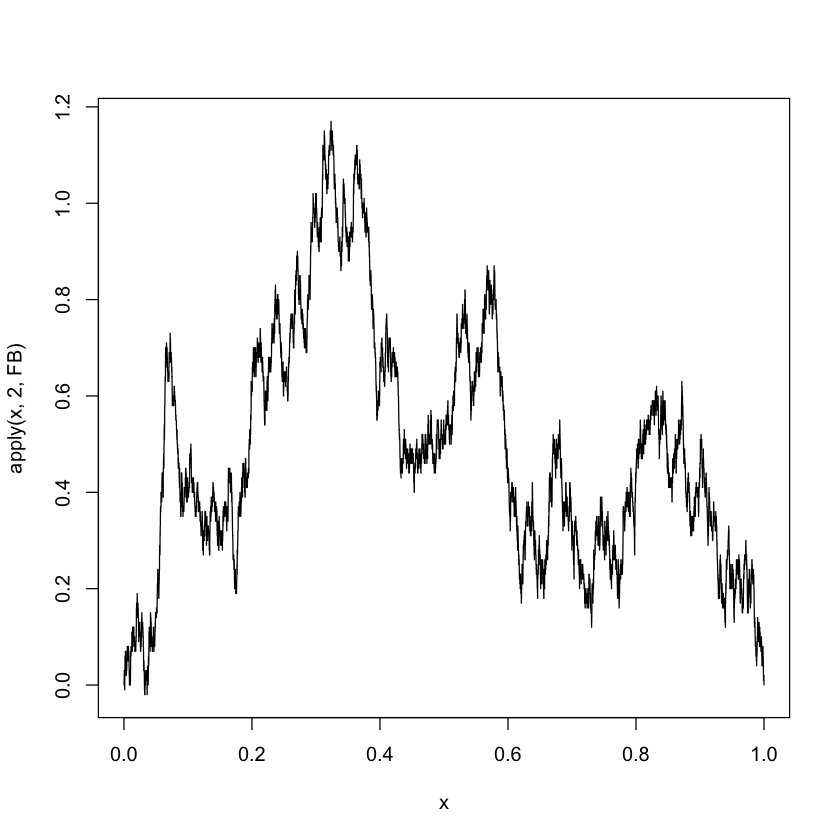

In [89]:
n=10000
U<-runif(n)
U<-sort(U)
Fn<- function(x) 1/n*sum((rep(x,n)-U>=0))
x=seq(1/n,1,by=1/n)
x<-matrix(x,nrow=1)
plot(x,apply(x,2,Fn),type ='s')
FB<-function(x) sqrt(n)*(Fn(x)-x)#c'est la fonction sqrt(n)*(Fn(x)-F(x))
plot(x,apply(x,2,FB),type ='s')

## 6.4(b)

In [90]:
n<-1000
x=seq(1/n,1,by=1/n)
x<-matrix(x,nrow=1)
#On simule une échantillons de loi sqrt(n)*||Fn-F||inf de taille 1000
X_B<-c()
FB_abs<-function(x) sqrt(n)*abs((Fn(x)-x))
for (i in 1:1000){
  U<-runif(n)
  U<-sort(U)
  Fn<- function(x) 1/n*sum((rep(x,n)-U>=0))
  X_B<-append(X_B,max(apply(x,2,FB)))
}

On simule une échantillons de loi $\mathrm{sup}(B_t)$ de taille 1000.

In [91]:
sup_B=c()
for(i in 1:1000){
  t<-seq(1/n,1,1/n)
  u<-rnorm(n,0,sqrt(1/n))
  W<-cumsum(u)
  B<-rep(0,n)
  for( i in 1:n) B[i]<-W[i]-t[i]*W[n]
  sup_B<-append(sup_B,max(B))
}

#### comparaison!

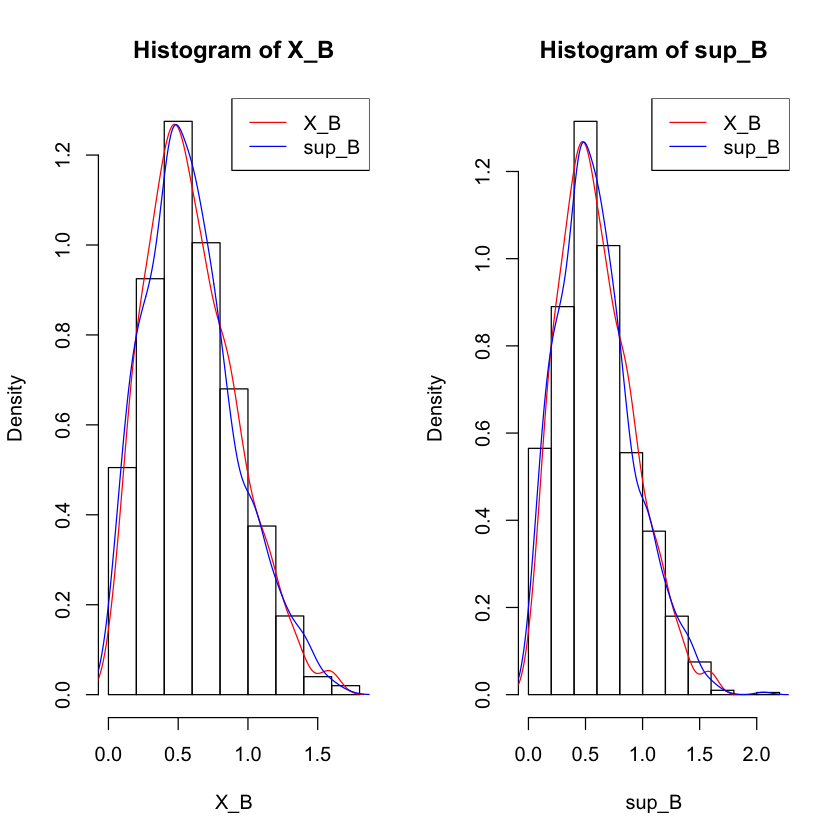

In [92]:
par(mfrow=c(1,2))
hist(X_B,probability = T)
lines(density(X_B),col='red')
lines(density(sup_B),col='blue')
legend("topright",c("X_B","sup_B"),col=c("red","blue"),lty=c(1,1))

hist(sup_B,probability = T)
lines(density(X_B),col='red')
lines(density(sup_B),col='blue')
legend("topright",c("X_B","sup_B"),col=c("red","blue"),lty=c(1,1))